# Bolt Take Home Task

The notebook is organized as follows:

- [Assignment and Analysis Plan](##Assignment-and-Analysis-Plan)
    - Assignment
    - Initial ideas/notes
    - Analysis plan
- [Data Loading and Cleaning](##Data-loading-and-cleaning)
    - [Config](###Config)
    - [Data load observations](####Data-load-observations)
    - [Data cleaning](###Data-cleaning)
    - [Feature engineering](###Feature-engineering)
- [Modeling](##Modeling)
    - [Interpretation of the modelling results](###Interpretation-of-the-modelling-results)
- [Example hexmap](##Example-hexmap)


## Assignment and Analysis Plan

**Goal:** Efficiently allocate supply so that riders can always get a ride and **drivers have stable earnings**.

**Assignment Objectives:**

- **Explore the data** and suggest a **solution to guide drivers towards areas** with higher expected demand at given times and locations.
- **Build and document a baseline model** for your solution.
- **Describe** how you would **design** and **deploy** such a model.
- **Communicate** how to present model recommendations to drivers.

**Data Description:**

- **start_time**: Time when the order was made.
- **start_lat**: Latitude of the order's pick-up point.
- **start_lng**: Longitude of the order's pick-up point.
- **end_lat**: Latitude of the order's destination point.
- **end_lng**: Longitude of the order's destination point.
- **ride_value**: Monetary value of this particular ride.

**Initial ideas:**

- Create a hexagonal ([bestagonal](https://www.youtube.com/watch?v=thOifuHs6eY)) heatmap with 15-minute forecasts. Drivers would see a heatmap with darker areas indicating higher expected demand.
- Predict demand in 15-minute intervals using time series models (ARMA, SARIMA) or machine learning models like XGBoost or LSTM.
- **Defining Demand:**
  - Number of requests in a 15-minute time window within a hexagon.
  - Consider incorporating monetary value of rides by weighting demand with ride prices.
- **Infrastructure:**
  - Use Docker containers on AWS ECS for storage and deployment.
  - Build an API using FastAPI for model serving and communication.
- **Evaluation Metrics:**
  - Determine appropriate metrics: driver response time to requests, minimizing unaccepted rides, maximizing revenue.
  - Measure the increase in drivers' earnings, which indirectly corresponds to company earnings and customer wait times.
  - Implement the recommendation system (heatmap and notifications) for a random sample of drivers and observe them over a period.
  - Use difference-in-differences (DiD) to evaluate system performance.

---

## Analysis Plan

### Data Loading

1. **Load Data**
1. **Inspect Data**
   - Check for missing values.
   - Check for duplicates.
   - Check for outliers.
   - Identify strange observations (e.g., using maps for visual inspection):
     - Coordinates outside of Tallinn.
     - Zero or excessively large distances.
     - Abnormally high monetary values.
     - Coordinates located in water bodies.
1. **Data Cleaning**
   - Handle missing values.
   - Remove duplicates.
   - Normalize data for modeling.
1. **Feature Engineering**
   - Extract day of the week.
   - Determine part of the day (morning, afternoon, evening, night).
   - Identify workdays and holidays.
   - Calculate Haversine distance (straight-line distance for simplicity).
   - Estimate travel time (if possible).
   - Round timestamps to the nearest 15 minutes (forecast window).
   - Bin data into hexagons using the H3 library.
   - Create lag features from demand (e.g., 15 minutes ago, 1 hour ago, 1 day ago, 1 week ago).
   - Compute rolling averages over the previous week (168 periods for 15-minute intervals).
   - Other Potential Features: Weather data, order end time, order acceptance time, unfulfilled orders, drive time.


### Exploratory Analysis

1. **Visualizations**
   - Plot geographic data on a map.
   - Analyze the distribution of monetary values.

### Modeling

1. **Model Selection**
   - **XGBoost Model**: Given the need to account for multiple areas and non-linear relationships, and considering time constraints, focus on using XGBoost for its efficiency and ability to handle complex data.
   - **Alternatives**:
     - **Time Series Models**: ARMA, SARIMA may require separate models for each area.
     - **Vector Autoregression**: Can account for multiple areas but may be complex to implement.
     - **Neural Networks**: LSTM networks could capture temporal and spatial dependencies but may require different data structures and more time.
1. **Train-Test Split**
   - Since the data is time series, split data based on time (e.g., train on past data, test on future data).
1. **Cross-Validation**
   - Implement a time series cross-validation scheme by splitting data into sequential time windows.
   - Use each window for testing while training on all previous data.

### Model Evaluation

1. **Performance Metrics**
   - Evaluate model performance on the test set using metrics like Mean Squared Error (MSE).
1. **Baseline Models**
   - **Previous Period Predictor**: Use demand from the previous 15-minute interval as the prediction.
   - **Moving Average Predictor**: Use the moving average of the previous four periods (1 hour) as the prediction.
   - **Seasonal Predictor**: Use demand from the same time in the previous week as the prediction.
1. **XGBoost Model Evaluation**
   - Compare the XGBoost model's performance against the baseline models.

### Model Deployment

- **API Development**: Build an API using FastAPI for model serving.
- **Containerization**: Use Docker containers on AWS ECS for deployment.
- **Data Storage**: Connect to a database for data storage and retrieval.
- **Considerations**:
  - Understand the cost of serving the model, might be too high compared to value added.
  - Think about changes in forecast windows (15 min is quite frequent) or data granularity.

### Model Communication

- **Visualization**: Display demand forecasts on a map within the driver app, using color-coded heatmaps to indicate areas of higher expected demand.
- **Notifications**: Send notification to drivers when demand is expected to pick up in specific areas.

### Experiment Design

- **Randomized Controlled Trial (RCT)**
  - **Treatment Group**: Drivers who receive the recommendation system (heatmap and notifications).
  - **Control Group**: Drivers who do not receive recommendations.
- **Evaluation Methodology**
  - Use a **Difference-in-Differences (DiD)** approach to compare the impact of the recommendation system.
  - Use pre- and post-implementation data to control for driver-specific characteristics, fixed effects, and other time-invariant factors.

**Difference-in-Differences Model:**

$$
\text{Outcome}_{it} = \beta_0 + \beta_1 \text{Post}_t + \beta_2 \text{Treatment}_i + \beta_3 (\text{Post}_t \times \text{Treatment}_i) + \gamma X_{it} + \alpha_i + \lambda_t + \varepsilon_{it}
$$

Where:

- $\text{Outcome}_{it}$: Outcome variable (e.g., earnings) for driver $i$ at time $t$.
- $\text{Post}_t$: Indicator variable (1 if after treatment, 0 if before).
- $\text{Treatment}_i$: Indicator variable (1 if driver is in the treatment group, 0 if control).
- $\text{Post}_t \times \text{Treatment}_i$: Interaction term capturing the treatment effect.
- $X_{it}$: Vector of control variables.
- $\alpha_i$: Driver fixed effects.
- $\lambda_t$: Time fixed effects.
- $\varepsilon_{it}$: Error term.

- **$\beta_3$** (Coefficient on the interaction term):
  - Estimates the **Average Treatment Effect (ATE)** of the intervention.
  - Represents the difference in changes over time between the treatment and control groups. Positive $\beta_3$ would indicate treatment had higher income compared to control after the intervention.


## Data loading and cleaning
<a id='##Data-loading-and-cleaning'></a>

### Config 
<a id='###Config'></a>

In [5]:
import folium
from folium.plugins import FastMarkerCluster
from geojson import Feature, FeatureCollection
import h3 # Using v.3.7.7
import json
import matplotlib.pyplot as plt
import matplotlib
import numpy as np
import pandas as pd

import seaborn as sns
from sklearn.metrics import mean_absolute_error, mean_squared_error
import xgboost as xgb

import warnings
warnings.filterwarnings('ignore')

# Helper functions that should be located in separate file

def haversine_distance(lat1: float, lon1: float, lat2: float, lon2: float) -> float:
    """
    Calculate harversine distance
    """
    R = 6371  # Earth's radius in kilometers

    # Convert latitude and longitude to radians
    lat1, lon1, lat2, lon2 = map(np.radians, [lat1, lon1, lat2, lon2])
                                 
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = np.sin(dlat/2)**2 + np.cos(lat1) * np.cos(lat2) * np.sin(dlon/2)**2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1-a))
    distance = R * c

    return distance

def plot_tallinn_basemap():
    """
    Plot basemap of Tallinn
    """
    return folium.Map(
    location=[59.437222, 24.745278],
    tiles="Cartodb Positron",
    zoom_start=10)

def lat_lng_to_h3(row: pd.Series, resolution: int = 8) -> str:
    """
    Convert latitude and longitude to H3 cell
    Pick res=8, which is approx. 1km2 https://h3geo.org/docs/core-library/restable
    """
    return h3.geo_to_h3(row['start_lat'], row['start_lng'], resolution)

def create_lags(data: pd.DataFrame, group_col: str, column: str) -> pd.DataFrame:
    """
    Create lag features for the specified column within each group, assuming 15 min intervals.
    """
    return data.assign(**{
        f'{column}_lag_quarter': data.groupby(group_col)[column].shift(1),
        f'{column}_lag_hour': data.groupby(group_col)[column].shift(4),
        f'{column}_lag_day': data.groupby(group_col)[column].shift(96),
        f'{column}_lag_week': data.groupby(group_col)[column].shift(672) # might be impractical as we have only 5 weeks of data
    })

# Modeling helpers 

def weekly_time_series_split(X:pd.DataFrame, y:pd.Series, n_splits:int):
    # Create custom CV splitter based on the weeks, to include all hex IDs
    unique_weeks = X['week'].unique()
    unique_weeks = sorted(unique_weeks)
    
    for i in range(n_splits):
        train_weeks = unique_weeks[:i+1]  # Use an increasing number of weeks for training
        test_week = unique_weeks[i+1]
        
        train_mask = X['week'].isin(train_weeks)
        test_mask = X['week'] == test_week
        
        yield np.where(train_mask)[0], np.where(test_mask)[0]

def evaluate_model(y_true:np.array, y_pred:np.array):
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    mae = mean_absolute_error(y_true, y_pred)
    return {'RMSE': rmse, 'MAE': mae}

def train_xgboost(X_train, y_train):
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, 
                             learning_rate=0.1, max_depth=6, subsample=0.8, random_state=123)
    model.fit(X_train, y_train)
    return model

def get_predictions(X_test, model):
    return {
        'xgboost': model.predict(X_test),
        'last_period': X_test['demand_count_lag_quarter'],
        'last_week': X_test['demand_count_lag_week']
    }

# Mapping helpers 

def hexagons_dataframe_to_geojson(df_hex, columns):
    """
    Produce the GeoJSON for a dataframe, constructing the geometry from the "hex_id" column
    and with a property matching the one in column_name
    """    
    list_features = []
    
    for i,row in df_hex.iterrows():
        try:
            geometry_for_row = {"type": "Polygon", "coordinates": [h3.h3_to_geo_boundary(h=row["h3_cell"], geo_json=True)]}
            properties = {col: row[col] for col in columns if col in row}
            feature = Feature(geometry=geometry_for_row, id=row["h3_cell"], properties=properties)
            list_features.append(feature)
        except:
            print("An exception occurred for hex " + row["h3_cell"]) 

    feat_collection = FeatureCollection(list_features)
    geojson_result = json.dumps(feat_collection)
    return geojson_result

def get_color(custom_cm, val, vmin, vmax):
    return matplotlib.colors.to_hex(custom_cm((val-vmin)/(vmax-vmin)))

def choropleth_map(df_aggreg:pd.DataFrame, column_name:str, feature_columns:list, color_map_name:str="Reds"):
    """
    Creates choropleth maps given the aggregated data. initial_map can be an existing map to draw on top of.
    """    
    #colormap
    min_value = df_aggreg[column_name].min()
    max_value = df_aggreg[column_name].max()
    
    initial_map = plot_tallinn_basemap()
    geojson_data = hexagons_dataframe_to_geojson(df_hex = df_aggreg, columns=feature_columns)
    custom_cm = matplotlib.cm.get_cmap(color_map_name)

    folium.GeoJson(
        geojson_data,
        style_function=lambda feature: {
            'fillColor': get_color(custom_cm, feature['properties'][column_name], vmin=min_value, vmax=max_value),
            'color': 'black',
            'weight': 1,
            'fillOpacity': 0.7 
        } 
    ).add_to(initial_map)

    return initial_map

In [6]:
ride_demand = pd.read_csv('./data/raw/robotex5.csv')

print(r"Missing values:", "\n", ride_demand.isnull().sum(), "\n") # No missing 
print(f"Number of duplicated rows: {ride_demand.duplicated().sum()}") # 4564 rows

ride_demand['distance'] = haversine_distance(
    ride_demand['start_lat'], ride_demand['start_lng'],
    ride_demand['end_lat'], ride_demand['end_lng']
)
ride_demand.describe()

Missing values: 
 start_time    0
start_lat     0
start_lng     0
end_lat       0
end_lng       0
ride_value    0
dtype: int64 

Number of duplicated rows: 4564


,start_lat,start_lng,end_lat,end_lng,ride_value,distance
count,627210.000000,627210.000000,627210.000000,627210.000000,627210.000000,627210.000000
mean,59.428682,24.743468,59.397797,24.724847,2.261384,9.480163
std,0.021764,0.056872,1.392755,1.650709,44.889892,198.035131
min,59.321557,24.505199,-37.819979,-122.453962,0.107628,0.005887
25%,59.418803,24.713140,59.415215,24.707919,0.545250,2.208340
50%,59.432069,24.744674,59.430697,24.744335,1.059000,4.287946
75%,59.439024,24.768115,59.439262,24.773924,1.712000,6.942635
max,59.566998,24.973743,61.552744,144.966110,3172.701000,15222.277114


In [7]:
# Plot quick map for visual inspection of trip end locations 
end_locations_map = (
    plot_tallinn_basemap()
    .add_child(FastMarkerCluster(ride_demand[['end_lat', 'end_lng']].values.tolist()))
)
end_locations_map


#### Data load observations
<a id='####Data-load-observations'></a>

- **Coordinates**:
  - Using a [mapping tool](https://www.keene.edu/campus/maps/tool/), I drew a rectangle around Tallinn and obtained coordinates for the area.
  - To check for coordinates outside of Tallinn, the latitude should be approximately between [59.3, 59.5] and longitude between [24.7, 25].
  - Start coordinates look correct; however, end coordinates have some issues.
- **Ride Value**:
  - The currency is not specified, but assuming the local currency (Euro), the minimum and maximum values appear to be outliers.
- **Distance**:
  - The maximum and minimum distances further suggest there are outliers in the data.
- **End Locations**:
  - Mapping the end locations shows that some endpoints are far outside of Tallinn, e.g., Helsinki, USA, or Australia.
  - **Solution**: I drew a 50 km circle from the center of Tallinn (59.437222, 24.745278, source: [Wikipedia](https://en.wikipedia.org/wiki/Tallinn)) and assumed that locations outside the circle should be dropped.


### Data cleaning
<a id='###Data-cleaning'></a>



In [8]:
# Draw 50 km circle around Tallinn
tallinn_center = (59.437222, 24.745278)
ride_demand['start_within_50km'] = ride_demand.apply(lambda x: haversine_distance(tallinn_center[0], tallinn_center[1], x['start_lat'], x['start_lng']) < 50, axis=1)
ride_demand['end_within_50km'] = ride_demand.apply(lambda x: haversine_distance(tallinn_center[0], tallinn_center[1], x['end_lat'], x['end_lng']) < 50, axis=1)

# Clean data
ride_demand_clean = (
    ride_demand
    .drop_duplicates()
    .query('start_within_50km and end_within_50km')
    .drop(columns=['start_within_50km', 'end_within_50km'])
    .query('distance > 0 and distance < 50')
    .query('ride_value > 0')
    .assign(
        # Round timestamps to the nearest 15 min - forcast window
        start_time=lambda df: pd.to_datetime(df['start_time']).dt.round('15min'),
        # Bin data into hexagons
        h3_cell=lambda df: df.apply(lat_lng_to_h3, axis=1) 
    )
)
# Clean data looks reasonable
ride_demand_clean.describe()


,start_time,start_lat,start_lng,end_lat,end_lng,ride_value,distance
count,621957,621957.000000,621957.000000,621957.000000,621957.000000,621957.000000,621957.000000
mean,2022-03-15 18:59:00.513412352,59.428685,24.743477,59.427160,24.744327,1.249834,5.057741
min,2022-03-01 00:00:00,59.321557,24.505199,58.989698,24.051660,0.107628,0.005887
25%,2022-03-09 00:00:00,59.418816,24.713161,59.415307,24.708014,0.544750,2.205823
50%,2022-03-16 08:15:00,59.432071,24.744677,59.430715,24.744343,1.057750,4.283067
75%,2022-03-22 21:30:00,59.439027,24.768125,59.439268,24.773916,1.709250,6.930429
max,2022-03-29 00:00:00,59.566998,24.973743,59.566624,25.538828,11.836250,47.474120
std,NaN,0.021763,0.056873,0.026381,0.067970,0.925960,3.757242


### Feature engineering
<a id='###Feature-engineering'></a>


In [9]:
# Create combination of all possible start times and h3 cells to ensure complete time series data
start_times = pd.DataFrame(ride_demand_clean['start_time'].unique(), columns=['start_time'])
h3_cells = pd.DataFrame(ride_demand_clean['h3_cell'].unique(), columns=['h3_cell'])
times_cells = pd.merge(start_times, h3_cells, how='cross')

demand_data = (
    pd.merge(times_cells, ride_demand_clean, on=['start_time', 'h3_cell'], how='left')
    .groupby(['h3_cell', 'start_time'], as_index=False)
    .agg(
        demand_value=('ride_value', 'sum'),   # Total ride value
        demand_count=('ride_value', 'count'), # Number of rides
    )
    .fillna(0)
    .assign(
        quarter=lambda df: df['start_time'].dt.minute // 15 + 1,
        hour=lambda df: df['start_time'].dt.hour,
        day_of_week=lambda df: df['start_time'].dt.dayofweek,
        part_of_day=lambda df: pd.cut(
            df['start_time'].dt.hour,
            bins=[-1, 5, 12, 17, 21, 24],
            labels=['night', 'morning', 'afternoon', 'evening', 'night'],
            right=True,
            ordered=False
        ),
        is_workday=lambda df: df['day_of_week'].isin([0, 1, 2, 3, 4]).astype(int),
        week=lambda df: df['start_time'].dt.isocalendar().week,
        hex_id_code=lambda df: df['h3_cell'].astype('category').cat.codes
    )
    .sort_values(['h3_cell', 'start_time'])
    .pipe(create_lags, group_col='h3_cell', column='demand_count')
    .pipe(create_lags, group_col='h3_cell', column='demand_value')
    .assign(
        lag_count_week_rolling=lambda df: df.groupby('h3_cell')['demand_count']
            .transform(lambda x: x.shift(672).rolling(window=672).mean()),
        lag_value_week_rolling=lambda df: df.groupby('h3_cell')['demand_value']
            .transform(lambda x: x.shift(672).rolling(window=672).mean()),
    )
    .sort_values(['start_time', 'h3_cell']) # reverse sort for model training, otherwise we split data based on hex ID
)

# Handle missing values by filling with zero
numeric_columns = demand_data.select_dtypes(include=[np.number]).columns
demand_data[numeric_columns] = demand_data[numeric_columns].fillna(0)

# Create dummies 
demand_data = pd.get_dummies(demand_data, columns=['part_of_day'], drop_first=True)

demand_data.tail()


,h3_cell,start_time,demand_value,demand_count,quarter,hour,day_of_week,is_workday,week,hex_id_code,...,demand_count_lag_week,demand_value_lag_quarter,demand_value_lag_hour,demand_value_lag_day,demand_value_lag_week,lag_count_week_rolling,lag_value_week_rolling,part_of_day_evening,part_of_day_morning,part_of_day_night
1333743,88089bcedbfffff,2022-03-29,0.0,0,1,0,1,1,13,495,...,1.0,0.0,6.987553,0.0,1.1685,0.535714,0.901754,False,False,True
1336432,88089bceddfffff,2022-03-29,0.0,0,1,0,1,1,13,496,...,0.0,0.0,0.000000,0.0,0.0000,0.305060,0.621124,False,False,True
1339121,88089bcee1fffff,2022-03-29,0.0,0,1,0,1,1,13,497,...,0.0,0.0,0.000000,0.0,0.0000,0.014881,0.046352,False,False,True
1341810,88089bcee3fffff,2022-03-29,0.0,0,1,0,1,1,13,498,...,0.0,0.0,0.000000,0.0,0.0000,0.000000,0.000000,False,False,True
1344499,88089bcee7fffff,2022-03-29,0.0,0,1,0,1,1,13,499,...,0.0,0.0,0.000000,0.0,0.0000,0.014881,0.037267,False,False,True


## Modelling 
<a id='##Modelling'></a>

In [10]:
features = [
    'quarter', 'hour', 'day_of_week', 'is_workday', 'week',
    'hex_id_code',
    'demand_count_lag_quarter', 'demand_count_lag_hour',
    'demand_count_lag_day', 'demand_count_lag_week',
    'demand_value_lag_quarter', 'demand_value_lag_hour',
    'demand_value_lag_day', 'demand_value_lag_week',
    'lag_count_week_rolling', 'lag_value_week_rolling',
    'part_of_day_evening', 'part_of_day_morning', 'part_of_day_night'
] 

X = demand_data[features]
y = demand_data['demand_count']

In [11]:
# tscv = TimeSeriesSplit(n_splits=4) # split data by week, there are 5 weeks in the dataset - was not working as intended as we need to make sure all hex IDs are in training and test

weeklycv = list(weekly_time_series_split(X, y, 4))

predictions = {}
for fold, (train_index, test_index) in enumerate(weeklycv, 1):
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]

    xgb_model = train_xgboost(X_train, y_train)
    preds = get_predictions(X_test, xgb_model)
    
    predictions[f'fold_{fold}'] = {
        model_name: {
            'predictions': pred,
            'errors': evaluate_model(y_test, pred)
        } for model_name, pred in preds.items()
    }
    predictions[f'fold_{fold}']['xgboost']['model'] = xgb_model
    predictions[f'fold_{fold}']['test_indices'] = test_index

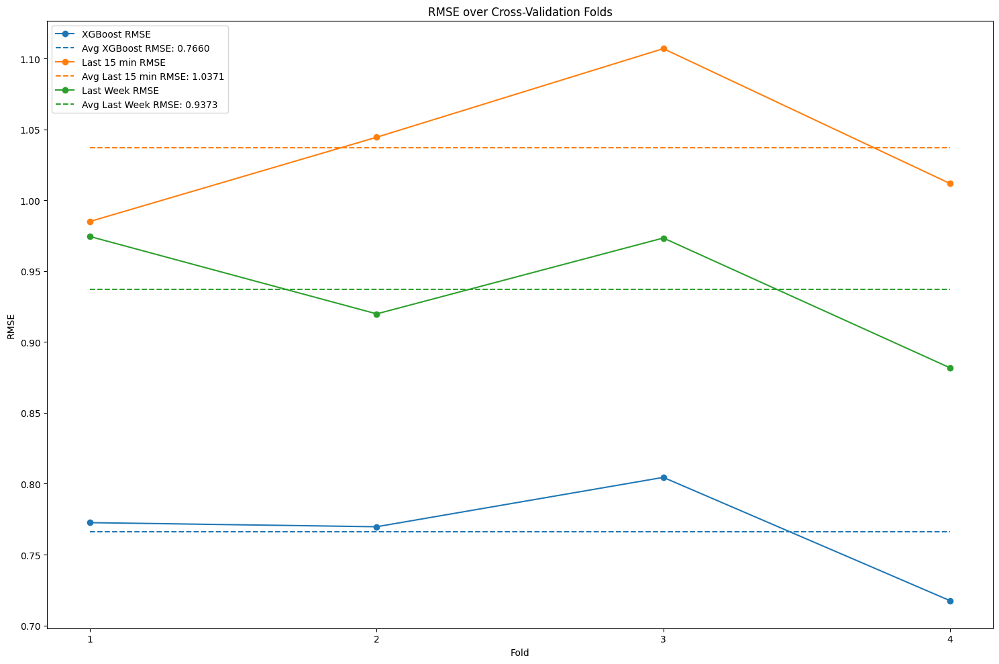

In [12]:
# Plot RMSE values 
rmse_data = {model: [] for model in ['XGBoost', 'Last 15 min', 'Last Week']}
folds = []

for fold, fold_data in predictions.items():
    folds.append(int(fold.split('_')[1]))  # Extract fold number
    rmse_data['XGBoost'].append(fold_data['xgboost']['errors']['RMSE'])
    rmse_data['Last 15 min'].append(fold_data['last_period']['errors']['RMSE'])
    rmse_data['Last Week'].append(fold_data['last_week']['errors']['RMSE'])

rmse_df = pd.DataFrame({
    'Fold': folds,
    'XGBoost': rmse_data['XGBoost'],
    'Last 15 min': rmse_data['Last 15 min'],
    'Last Week': rmse_data['Last Week']
})

plt.figure(figsize=(15, 10))

for model in ['XGBoost', 'Last 15 min', 'Last Week']:
    plt.plot(rmse_df['Fold'], rmse_df[model], marker='o', label=f'{model} RMSE')
    avg_rmse = rmse_df[model].mean()
    plt.hlines(avg_rmse, xmin=rmse_df['Fold'].min(), xmax=rmse_df['Fold'].max(), 
               colors=plt.gca().lines[-1].get_color(), linestyles='dashed', 
               label=f'Avg {model} RMSE: {avg_rmse:.4f}')

plt.title('RMSE over Cross-Validation Folds')
plt.xlabel('Fold')
plt.xticks(range(1,5))
plt.ylabel('RMSE')
plt.legend(loc='upper left')
plt.tight_layout()
plt.show()

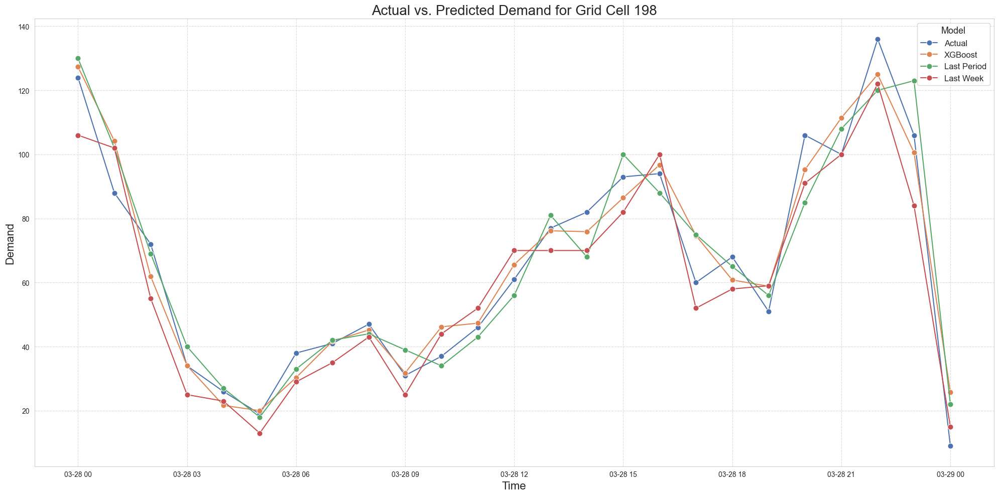

In [13]:
# Visualize last fold
n = 4
fold_data = predictions[f"fold_{n}"]
test_indices = predictions[f"fold_{n}"]['test_indices']

# Find grid cell with the highest demand
top_grids = demand_data.groupby(['hex_id_code'])['demand_count'].sum().sort_values(ascending=False).head(10)
top_grid_code = top_grids.index[0]

grid_mask = X.iloc[test_indices]['hex_id_code'] == top_grid_code
filtered_indices = test_indices[grid_mask]

# Actual and predicted values for hex cell
y_actual = y.iloc[filtered_indices]
y_pred_xgb = fold_data['xgboost']['predictions'][grid_mask]
y_pred_last_period = fold_data['last_period']['predictions'][grid_mask]
y_pred_last_week = fold_data['last_week']['predictions'][grid_mask]
plot_times = demand_data.iloc[filtered_indices]['start_time']

plot_df = pd.DataFrame({
    'Time': plot_times,
    'Actual': y_actual.values,
    'XGBoost': y_pred_xgb,
    'Last Period': y_pred_last_period.values,
    'Last Week': y_pred_last_week.values
})

plot_df.sort_values('Time', inplace=True)
plot_df.set_index('Time', inplace=True)

# Resample the data to 1h intervals to make plot cleaner 
plot_df_resampled = plot_df.resample('1h').sum().reset_index()

plot_df_melted = pd.melt(plot_df_resampled, id_vars=['Time'], var_name='Model', value_name='Demand')

sns.set_style("whitegrid")
sns.set_palette("deep")

# Create the plot
plt.figure(figsize=(20, 10))
g = sns.lineplot(data=plot_df_melted, x='Time', y='Demand', hue='Model', marker='o', markersize=8)

plt.title(f'Actual vs. Predicted Demand for Grid Cell {top_grid_code}', fontsize=20)
plt.xlabel('Time', fontsize=16)
plt.ylabel('Demand', fontsize=16)
plt.legend(title='Model', title_fontsize='13', fontsize='12')

plt.grid(True, linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [14]:
# Get feature importances
importances = fold_data['xgboost']['model'].feature_importances_
feature_names = X_train.columns
importance_df = pd.DataFrame({
    'Feature': feature_names,
    'Importance': importances
}).sort_values('Importance', ascending=False)

print(importance_df)

                     Feature  Importance
6   demand_count_lag_quarter    0.401350
8       demand_count_lag_day    0.386878
7      demand_count_lag_hour    0.074072
9      demand_count_lag_week    0.057039
14    lag_count_week_rolling    0.014190
4                       week    0.010563
5                hex_id_code    0.008550
18         part_of_day_night    0.007157
15    lag_value_week_rolling    0.006142
1                       hour    0.005494
2                day_of_week    0.005271
16       part_of_day_evening    0.004429
17       part_of_day_morning    0.003793
11     demand_value_lag_hour    0.003411
13     demand_value_lag_week    0.003203
10  demand_value_lag_quarter    0.003179
12      demand_value_lag_day    0.002953
0                    quarter    0.002325
3                 is_workday    0.000000


### Interpretation of the modelling results 
<a id='###Interpretation-of-the-modelling-results'></a>

* From the feature importance table, the most significant features contributing to the XGBoost model's prediction are related to time. Previous period (15 min), day, and hour demand seem to be the most important features. Other non-time-series features such as week, hexagon ID, and part of the day are less important but still informative. Could be valuable to add other features, such as weather and traffic, currently not in the data.

* The XGBoost model has an average RMSE of 0.766, performing better than the simple baselines based on lag values. This indicates that there is value in adding features other than autoregressive ones.

* XGBoost predictions (orange) generally follow the actual demand curve closely, though some deviations occur at peaks and troughs. Naive predictors also follow the demand trend well but lag behind (by design) and do not adjust to short-term fluctuations as well as the XGBoost model.


## Example hexmap
<a id='##Example-hexmap'></a>


In [15]:
hex_mapping = demand_data[['h3_cell', 'hex_id_code']].drop_duplicates()

demand_predicted = X.iloc[test_indices]
demand_predicted['actual_demand'] = y.iloc[test_indices]
demand_predicted['xgboost_prediction'] = predictions['fold_4']['xgboost']['predictions']
demand_predicted = pd.merge(demand_predicted, hex_mapping, on='hex_id_code', how='left')

# In last fold we make prediction for Monday 28. Mar, let's plot it 
single_period = demand_predicted.query('day_of_week == 0 and hour == 0 and quarter == 1')
choropleth_map(single_period,'xgboost_prediction', ['xgboost_prediction'])
